In [1]:
import numpy as np
import matplotlib.pyplot as plt
import SimpleITK as sitk 


In [2]:
import tigre
from tigre import geometry, Ax

In [3]:
category = 'chest'

In [4]:
from src.data.data_load.data_load_chest import load_data_chest
vol_HU, spacing_dzyx, meta = load_data_chest(
    '1', modality = "CT"
)

In [5]:
from src.data.data_process import (
    hu_to_attenuation, attenuation_to_gray, normalize_volume_minmax
)

In [6]:
meta

{'series_dir': '/home/xm/project1/data/raw/chest/manifest-1600709154662/LIDC-IDRI/LIDC-IDRI-0001/01-01-2000-NA-NA-30178/3000566.000000-NA-03192',
 'num_files': 133,
 'first_file': '/home/xm/project1/data/raw/chest/manifest-1600709154662/LIDC-IDRI/LIDC-IDRI-0001/01-01-2000-NA-NA-30178/3000566.000000-NA-03192/1-133.dcm',
 'patient_id': 'LIDC-IDRI-0001',
 'study_uid': '1.3.6.1.4.1.14519.5.2.1.6279.6001.298806137288633453246975630178',
 'series_uid': '1.3.6.1.4.1.14519.5.2.1.6279.6001.179049373636438705059720603192',
 'series_description': '',
 'manufacturer': 'GE MEDICAL SYSTEMS',
 'modality_detected': 'CT',
 'modality_used': 'CT',
 'pixel_spacing_tag': '0.703125\\0.703125 ',
 'slice_thickness_tag': '2.500000',
 'spacing_between_slices_tag': '',
 'rescale_slope': '1 ',
 'rescale_intercept': '-1024 ',
 'shape_zyx': (133, 512, 512),
 'dtype': 'int32',
 'xml_paths': ['/home/xm/project1/data/raw/chest/manifest-1600709154662/LIDC-IDRI/LIDC-IDRI-0001/01-01-2000-NA-NA-30178/3000566.000000-NA-031

In [7]:
raw_path = meta['series_dir']
shape = meta['shape_zyx']
voxel_spacing = spacing_dzyx

In [8]:
print("\n=== Volume_HU ===")
print("shape (Z,Y,X):", vol_HU.shape)
print("spacing (dz,dy,dx) [mm]:", voxel_spacing)
print("value range (HU)       :", int(vol_HU.min()), "→", int(vol_HU.max()))
print("dtype:", vol_HU.dtype)


=== Volume_HU ===
shape (Z,Y,X): (133, 512, 512)
spacing (dz,dy,dx) [mm]: (2.5, 0.703125, 0.703125)
value range (HU)       : -2048 → 3071
dtype: int32


In [9]:
from src.data.data_process.projection import get_projections

In [10]:
[nz, ny, nx] = vol_HU.shape    
[dz, dy, dx] = voxel_spacing    

In [11]:
voxel_spacing

(2.5, 0.703125, 0.703125)

In [12]:
vol_xyz = np.asarray(vol_HU, dtype=np.float32).transpose(2, 1, 0)
vol_xyz.shape

(512, 512, 133)

In [13]:
voxel_spacing = np.array([dx, dy, dz])

In [14]:
def reorient_for_axis(vol_xyz, geo, axis='z', voxel_spacing=None):
    """
    将当前体数据 vol_xyz（形状为 (x,y,z)）重排，使“想绕的轴 axis”映射为 z。
    同步更新 geo['nVoxel'], geo['dVoxel'], offOrigin，并返回新的 voxel_spacing。
    参数:
      - vol_xyz: ndarray, 形状 (x,y,z)
      - geo: dict, 至少包含键 'nVoxel', 'dVoxel', 'offOrigin'
      - axis: 'x' | 'y' | 'z'，表示你想“绕”的原始轴
      - voxel_spacing: 可选，(dx,dy,dz)。若为 None，则使用 geo['dVoxel'] 作为来源
    返回:
      - vol_perm: 重排后的体 (x',y',z')
      - geo2: 同步更新后的 geo
      - spacing_new: 重排后的 (dx',dy',dz')，np.float32
    说明:
      - 若 axis='y'，就把“旧的 y”映射为新 z'；若 axis='x'，把“旧的 x”映射为新 z'。
      - angles 仍按“绕 z”的约定传入投影函数即可（因为我们已把目标轴映射到 z）。
    """
    assert axis in ('x','y','z'), f"axis 必须是 'x'/'y'/'z'，收到 {axis}"

    # perm: 新 (x',y',z') 分别取自旧 (x,y,z) 的哪个下标
    if axis == 'z':
        perm = (0, 1, 2)     # 不变：绕 z（默认）
    elif axis == 'y':
        perm = (0, 2, 1)     # 让旧 y -> 新 z'
    else:  # axis == 'x'
        perm = (2, 1, 0)     # 让旧 x -> 新 z'

    # 1) 重排体数据
    vol_perm = np.transpose(vol_xyz, perm)

    # 2) 生成新的 spacing 来源
    if voxel_spacing is None:
        spacing_src = np.asarray(geo['dVoxel'], dtype=np.float32)  # [dx,dy,dz]
    else:
        spacing_src = np.asarray(voxel_spacing, dtype=np.float32)  # [dx,dy,dz]

    # 3) 同步更新 geo
    geo2 = geo.copy()

    # nVoxel/dVoxel 按 perm 重排
    nx, ny, nz = vol_xyz.shape
    nvoxel_new = np.array([ [nx,ny,nz][i] for i in perm ], dtype=np.int32)
    dvoxel_new = np.array([ spacing_src[i] for i in perm ], dtype=np.float32)
    geo2['nVoxel'] = nvoxel_new
    geo2['dVoxel'] = dvoxel_new

    # offOrigin 同步重排（若存在）
    if 'offOrigin' in geo2 and len(geo2['offOrigin']) == 3:
        ox, oy, oz = map(float, geo2['offOrigin'])
        geo2['offOrigin'] = np.array([ [ox,oy,oz][i] for i in perm ], dtype=np.float32)

    # 其余几何量（DSD/DSO/nDetector/dDetector/offDetector/COR/rotDetector）保持不变
    # 返回 triple：体、geo、spacing
    return vol_perm, geo2, dvoxel_new


In [15]:
geo_dict = {
    # Distances
    "DSD": 1000.0,   # Distance Source Detector (mm)
    "DSO": 600.0,   # Distance Source Origin   (mm)

    # Detector parameters
    "nDetector": np.array([256, 256], dtype=np.int32),   # [nu, nv] = [width, height] (px)
    "dDetector": np.array([2.0, 2.0], dtype=np.float32), # [du, dv] (mm/px)

    # Image parameters
    "nVoxel": np.array([nx, ny, nz], dtype=np.int32),       # [nx, ny, nz]
    "dVoxel": np.array([dx, dy, dz], dtype=np.float32),     # [dx, dy, dz] (mm/vx)

    # Offsets
    "offOrigin":   np.array([0.0, 0.0, 0.0], dtype=np.float32),
    "offDetector": np.array([0.0, 0.0],       dtype=np.float32),

    # Mode & misc
    "mode": "cone",
    "accuracy": 0.5,
    "filter": "ram-lak",   # 供重建算法用，对 Ax 前向投影本身无影响

    # 可选（有的代码不会用到，但保留以便一致）
    "COR": 0.0,                                        # center of rotation (mm)
    "rotDetector": np.array([0.0, 0.0, 0.0], dtype=np.float32),  # (rad)
}


In [16]:
geo_dict_parallel = {
    # Distances
    "DSD": 1000.0,   # Distance Source Detector (mm)
    "DSO": 600.0,   # Distance Source Origin   (mm)

    # Detector parameters
    "nDetector": np.array([256, 256], dtype=np.int32),   # [nu, nv] = [width, height] (px)
    "dDetector": np.array([2.0, 2.0], dtype=np.float32), # [du, dv] (mm/px)

    # Image parameters
    "nVoxel": np.array([nx, ny, nz], dtype=np.int32),       # [nx, ny, nz]
    "dVoxel": np.array([dx, dy, dz], dtype=np.float32),     # [dx, dy, dz] (mm/vx)

    # Offsets
    "offOrigin":   np.array([0.0, 0.0, 0.0], dtype=np.float32),
    "offDetector": np.array([0.0, 0.0],       dtype=np.float32),

    # Mode & misc
    "mode": "parallel",
    "accuracy": 0.5,
    "filter": "ram-lak",   # 供重建算法用，对 Ax 前向投影本身无影响

    # 可选（有的代码不会用到，但保留以便一致）
    "COR": 0.0,                                        # center of rotation (mm)
    "rotDetector": np.array([0.0, 0.0, 0.0], dtype=np.float32),  # (rad)
}


In [17]:
vol_xyz, geo_dict, voxel_spacing = reorient_for_axis(vol_xyz, geo_dict, axis='x')

In [18]:
geo_dict_parallel = geo_dict
geo_dict_parallel["mode"] = "parallel"

In [19]:
from src.data.data_process.projection import to_tigre_geometry
geo = to_tigre_geometry(geo_dict)

In [20]:
angles_deg = np.arange(0, 360, 3, dtype=np.float32)

In [21]:
from vis.proj.proj_vis import save_projs_2d

In [22]:
projs = get_projections(vol_xyz, geo_dict, angles_deg, 'HU')
projs_parallel = get_projections(vol_xyz, geo_dict_parallel, angles_deg, 'HU')

In [23]:
paths = save_projs_2d(
    projs=projs,
    angles_deg=angles_deg,
    category="chest",       #  figs/projections/category/
    save_path=None,         
    window=(1, 99),
    origin="lower",         # 如需倒置改 "lower"
)

In [24]:
paths_parallel = save_projs_2d(
    projs=projs_parallel,
    angles_deg=angles_deg,
    category="chest",       #  figs/projections/category/
    save_path="figs/projections/chest/" + "parallel/",         
    window=(1, 99),
    origin="lower",         # 如需倒置改 "lower"
)

In [25]:
vol = normalize_volume_minmax(attenuation_to_gray(hu_to_attenuation(vol_xyz)))

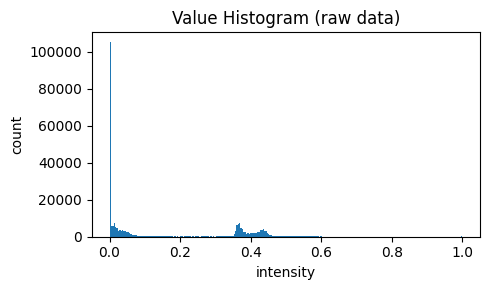

In [26]:
sample = np.asarray(vol[:: max(1, shape[0]//50), ::8, ::8]).ravel()  # 稀疏采样
plt.figure(figsize=(5,3))
plt.hist(sample, bins=256)
plt.title("Value Histogram (raw data)")
plt.xlabel("intensity")
plt.ylabel("count")
plt.tight_layout()
plt.show()

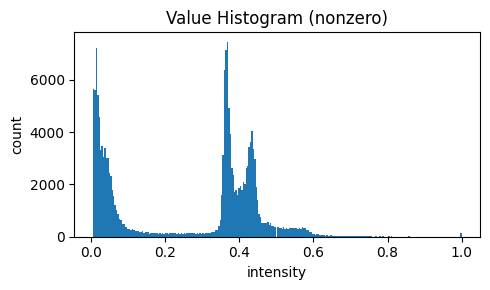

In [27]:
sample = np.asarray(vol[:: max(1, shape[0]//50), ::8, ::8]).ravel()  # 稀疏采样
sample_nonzero = sample[sample != 0]
plt.figure(figsize=(5,3))
plt.hist(sample_nonzero, bins=256)
plt.title("Value Histogram (nonzero)")
plt.xlabel("intensity")
plt.ylabel("count")
plt.tight_layout()
plt.show()

In [28]:
def show_slice(img2d, vmin=None, vmax=None, title=""):
    plt.figure(figsize=(5,5))
    plt.imshow(img2d, cmap="gray", vmin=vmin, vmax=vmax)
    plt.title(title)
    plt.axis("off")
    plt.show()

def to_xyz(vol, order="zyx"):
    """
    将当前体数据 vol（轴顺序由 order 指定，如 'zyx' 或 'xyz'）
    转换为统一的 (x,y,z) 顺序，便于后续一致地取切片。
    """
    order = order.lower()
    assert set(order) == set("xyz"), f"order 必须是 'xyz' 的排列，收到 {order}"
    perm = [order.index('x'), order.index('y'), order.index('z')]
    return np.transpose(vol, perm)

def show_orthogonal(vol, order="zyx", vmin=None, vmax=None):
    """
    以正确的几何含义绘制三正交面：
    - Axial（轴向）：固定 z，看 XY（显示顺序为 Y×X）
    - Coronal（冠状）：固定 y，看 XZ（显示为 Z×X）
    - Sagittal（矢状）：固定 x，看 YZ（显示为 Z×Y）
    """
    vol_xyz = to_xyz(vol, order=order)   # -> (x,y,z)
    nx, ny, nz = vol_xyz.shape
    x_mid, y_mid, z_mid = nx//2, ny//2, nz//2

    # 自动窗宽
    if vmin is None or vmax is None:
        low, high = np.percentile(vol_xyz, [1, 99.5])
        vmin = low if vmin is None else vmin
        vmax = high if vmax is None else vmax

    # Axial: XY at fixed z -> (y, x)
    axial = vol_xyz[:, :, z_mid].T               # (y,x)
    show_slice(axial, vmin=vmin, vmax=vmax, title=f"Axial [z={z_mid}]")

    # Coronal: XZ at fixed y -> (z, x)
    coronal = vol_xyz[:, y_mid, :].T             # (z,x)
    show_slice(coronal, vmin=vmin, vmax=vmax, title=f"Coronal [y={y_mid}]")

    # Sagittal: YZ at fixed x -> (z, y)
    sagittal = vol_xyz[x_mid, :, :].T            # (z,y)
    show_slice(sagittal, vmin=vmin, vmax=vmax, title=f"Sagittal [x={x_mid}]")

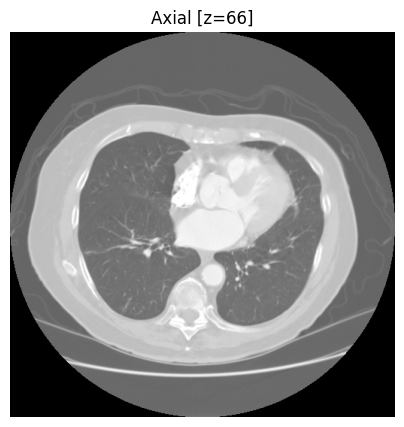

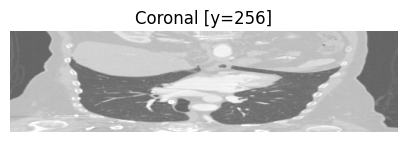

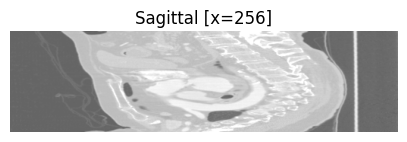

In [29]:
show_orthogonal(vol_HU, order="zyx")

In [30]:
from skimage.measure import marching_cubes
import trimesh

iso = np.percentile(vol, 99)  # 你可以微调阈值
verts, faces, normals, _ = marching_cubes(vol.astype(np.float32), level=iso, spacing=voxel_spacing)
mesh = trimesh.Trimesh(verts, faces, vertex_normals=normals, process=False)
mesh.show()

In [31]:
# # 灰度累积投影

# import os
# import time
# import numpy as np
# from scipy.ndimage import rotate
# from tqdm import tqdm
# from matplotlib import pyplot as plt

# def _pad_to_safe_cube(vol, cval=0.0):
#     """
#     将(Z,Y,X)体数据填充为边长L的立方体，以避免任意绕Y/Z旋转时被裁剪。
#     取 L = ceil(max(Z,Y,X) * sqrt(3))，并将原体素居中放置。
#     返回：padded_vol (L,L,L)
#     """
#     z, y, x = vol.shape
#     L = int(np.ceil(max(z, y, x) * np.sqrt(3)))  # 保守上界
#     pad_z_total = max(0, L - z)
#     pad_y_total = max(0, L - y)
#     pad_x_total = max(0, L - x)
#     pad_width = (
#         (pad_z_total // 2, pad_z_total - pad_z_total // 2),
#         (pad_y_total // 2, pad_y_total - pad_y_total // 2),
#         (pad_x_total // 2, pad_x_total - pad_x_total // 2),
#     )
#     padded = np.pad(vol, pad_width, mode="constant", constant_values=cval)
#     return padded

# def project_volume_orthographic(
#     vol_normalized,
#     azimuth_deg=0.0,        # 水平转角（绕 Z 轴），x->y 为正
#     elevation_deg=30.0,     # 俯仰角（绕 Y 轴），x->z 为正
#     spacing=(1.0, 1.0, 1.0),# 体素尺寸(dz, dy, dx)
#     mode="sum",             # {"sum","mean","mip"}
#     order=1,                # 插值阶数：0=邻近，1=线性，3=三次样条
#     cval=0.0,               # 旋转边界填充值
#     safe_same_size=True     # True: 先pad到安全立方体，并固定输出尺寸
# ):
#     """
#     返回 2D 投影(np.float32)。旋转顺序：先绕Y轴(elevation)，再绕Z轴(azimuth)；投影方向为旋转后体数据的+Z方向。
#     """
#     vol = vol_normalized.astype(np.float32, copy=False)
#     if safe_same_size:
#         vol = _pad_to_safe_cube(vol, cval=cval)

#     dz, dy, dx = spacing


    
#     # 1) 俯仰角（绕 X 轴，上下倾斜）保持不变
#     vol_rot = rotate(vol, angle=elevation_deg, axes=(1, 0), reshape=False,
#                  order=order, mode='constant', cval=cval)

#     # 2) 左右扫动（绕 Y 轴）
#     vol_rot = rotate(vol_rot, angle=azimuth_deg, axes=(0, 2), reshape=False,
#                  order=order, mode='constant', cval=cval)


#     # 3) 沿 Z 轴做投影
#     if mode == "sum":
#         proj = vol_rot.sum(axis=0) * dz
#     elif mode == "mean":
#         proj = vol_rot.mean(axis=0)
#     elif mode == "mip":
#         proj = vol_rot.max(axis=0)
#     else:
#         raise ValueError("mode must be one of {'sum','mean','mip'}")

#     return proj.astype(np.float32, copy=False)

# def save_rotation_projections(
#     vol_normalized,
#     raw_path,
#     elevation_deg=0.0,
#     mode="sum",
#     step_deg=3.0,           # 每帧角度增量
#     total_deg=360.0,        # 总角度
#     order=1,
#     cval=0.0,
#     spacing=(1.0,1.0,1.0),
#     progress_desc="Saving projections"
# ):
#     """
#     绕 Y 轴生成投影，输出目录和文件名格式：
#     - 目录: Proj_elevation_{elevation_deg}
#     - 文件: angle_{角度}.png
#     """
#     assert step_deg > 0, "step_deg 必须为正数"
#     n_frames = int(np.ceil(total_deg / step_deg))
#     azimuths = (np.arange(n_frames) * step_deg) % 360.0

#     # 输出目录
#     out_dir = os.path.join(raw_path, f"Proj_elevation_{elevation_deg}")
#     print(f"Save dir: {out_dir}")
#     os.makedirs(out_dir, exist_ok=True)

#     t0 = time.time()
#     saved = []

#     with tqdm(total=n_frames, desc=progress_desc) as pbar:
#         for i, az in enumerate(azimuths):
#             proj = project_volume_orthographic(
#                 vol_normalized,
#                 azimuth_deg=float(az),
#                 elevation_deg=float(elevation_deg),
#                 spacing=spacing,
#                 mode=mode,
#                 order=order,
#                 cval=cval,
#                 safe_same_size=True
#             )
#             # 文件名改为 angle_x.png
#             fname = os.path.join(out_dir, f"angle_{int(round(az))}.png")
#             plt.imsave(fname, proj, cmap="gray")
#             saved.append((float(az), fname))
#             pbar.set_postfix({"angle_deg": f"{az:.1f}"})
#             pbar.update(1)

#     elapsed = time.time() - t0
#     print(f"⏱️ Total time: {elapsed:.2f} s | Frames: {n_frames} | Output dir: {out_dir}")

#     return {
#         "out_dir": out_dir,
#         "frames": saved,
#         "elapsed_sec": elapsed,
#         "n_frames": n_frames
#     }


In [32]:
# info = save_rotation_projections(
#     vol,
#     raw_path=save_root,   # 会在此目录下新建子文件夹
#     elevation_deg=30.0,
#     mode="sum",               # 可选 "sum" / "mean" / "mip"
#     step_deg=3.0,             # 每帧 +3°
#     total_deg=360.0,          # 绕一圈；
#     order=1,
#     cval=0.0,
#     spacing=(1.0,1.0,1.0),
#     progress_desc="Projection loop"
# )